<a href="https://colab.research.google.com/github/riyabharath24/Improving-Image-Resolution-SRCNN/blob/main/Improving_Image_Resolution_SRCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

****Improving Image Resolution using SRCNN****

Contributors:
Riya Bharathwaj(RA2011027010062)

Manasa N(RA2011027010022)

This model involves the use of image super resolution using a super-resolution convolutional neural network. It uses different parameters such as the peak-signal-to noise ratio(psnr), mean squared error(mse) and the structural similarity of images to compare degraded images and original images, and create a neural network that improves the resolution of blurred images to make it look more similar to the original and obtain the original quality.

Dataset Link: http://mmlab.ie.cuhk.edu.hk/projects/SRCNN.html

**1.Loading the Dataset**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import sys
import keras
import cv2
import numpy
import matplotlib
import skimage

from keras.models import Sequential
from keras.layers import Conv2D
from keras.optimizers import Adam
from skimage.metrics import structural_similarity
from matplotlib import pyplot as plt
import numpy as np
import math
import os
%matplotlib inline

**2. Defining Image Parameters**

In [ ]:
#peak_signal_to_noise_ratio
def psnr(target, ref):
  target_data=target.astype(float)
  ref_data=ref.astype(float)

  diff=ref_data-target_data
  diff=diff.flatten('C')

  mse=(np.mean(diff**2.))
  #if(mse == 0):
    #return 100
  return 20*math.log10(255./math.sqrt(mse))

#mean square error
def mse(target,ref):
  err=np.sum((target.astype('float')-ref.astype('float'))**2)
  err=err/float(target.shape[0]*target.shape[1])

  return err

def ssim(target,ref):
  s = structural_similarity(target, ref,multichannel=True)
  return s

In [ ]:
#function to combine all three metrics

def compare_images(target,ref):
  scores=[]
  scores.append(psnr(target,ref))
  scores.append(mse(target,ref))
  scores.append(ssim(target,ref))

  return scores

In [ ]:
def prepare_images(path, factor):

    # loop through the files in the directory
    for file in os.listdir(path):
        try:
          # open the file
          img = cv2.imread(path + '/' + file)

          # find old and new image dimensions
          h, w, _ = img.shape
          new_height = int(h / factor)
          new_width = int(w / factor)

          # resize the image - down
          img = cv2.resize(img, (new_width, new_height), interpolation = cv2.INTER_LINEAR)

          # resize the image - up
          img = cv2.resize(img, (w, h), interpolation = cv2.INTER_LINEAR)



          # save the image
          print('Saving {}'.format(file))
          cv2.imwrite('/content/drive/MyDrive/images/{}'.format(file), img)
        except:
          print('ERROR for file-', file, '!')
          pass




In [ ]:
images= prepare_images('/content/drive/MyDrive/source/', 2)

Saving coastguard.bmp
Saving bridge.bmp
Saving barbara.bmp
Saving baboon.bmp
Saving pepper.bmp
Saving comic.bmp
Saving man.bmp
Saving monarch.bmp
Saving lenna.bmp
Saving face.bmp
Saving foreman.bmp
Saving flowers.bmp
Saving butterfly_GT.bmp
Saving woman_GT.bmp
Saving zebra.bmp
Saving head_GT.bmp
Saving bird_GT.bmp
Saving baby_GT.bmp
Saving ppt3.bmp


In [ ]:
#displaying scores of images

for file in os.listdir('/content/drive/MyDrive/images'):

  try:

    target=cv2.imread('/content/drive/MyDrive/images/{}'.format(file))
    ref=cv2.imread('/content/drive/MyDrive/source/{}'.format(file))

    scores=compare_images(target,ref)

    print('{}\nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(file, scores[0], scores[1], scores[2]))

  except:
    pass
  #print(scores)


<ipython-input-48-e76d2b18cd91>:22: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  s = structural_similarity(target, ref,multichannel=True)


baboon.bmp
PSNR: 22.157084083442548
MSE: 1187.1161333333334
SSIM: 0.629277587900277

zebra.bmp
PSNR: 27.909840639329513
MSE: 315.6585459528818
SSIM: 0.8911656209329116

ppt3.bmp
PSNR: 24.84926168950471
MSE: 638.6684263912582
SSIM: 0.9284023942315316

man.bmp
PSNR: 27.22646369798821
MSE: 369.4496383666992
SSIM: 0.8214950645456561

pepper.bmp
PSNR: 29.88947161686106
MSE: 200.1033935546875
SSIM: 0.8357937568464359

lenna.bmp
PSNR: 31.47349297867539
MSE: 138.94800567626953
SSIM: 0.8460989200521499

foreman.bmp
PSNR: 30.14456532664372
MSE: 188.6883483270202
SSIM: 0.933268417388899

flowers.bmp
PSNR: 27.454504805386144
MSE: 350.55093922651935
SSIM: 0.8697286286974628

face.bmp
PSNR: 30.99220650287191
MSE: 155.23189718546524
SSIM: 0.8008439492289884

coastguard.bmp
PSNR: 27.161600663887082
MSE: 375.00887784090907
SSIM: 0.756950063354931

comic.bmp
PSNR: 23.799861502225532
MSE: 813.2338836565096
SSIM: 0.8347335416398209

monarch.bmp
PSNR: 30.196242365288896
MSE: 186.45643615722656
SSIM: 0.9439

**3. Training the Model**

SRCNN was trained on the luminescence channel in the YCrCb color space

In [ ]:
# define the SRCNN model
def model():

    # define model type
    SRCNN = Sequential()

    #add model layers;filters =no. of nodes in the layer
    SRCNN.add(Conv2D(filters=128, kernel_size = (9, 9), kernel_initializer='glorot_uniform',
                     activation='relu', padding='valid', use_bias=True, input_shape=(None, None, 1)))
    SRCNN.add(Conv2D(filters=64, kernel_size = (3, 3), kernel_initializer='glorot_uniform',
                     activation='relu', padding='same', use_bias=True))
    SRCNN.add(Conv2D(filters=1, kernel_size = (5, 5), kernel_initializer='glorot_uniform',
                     activation='linear', padding='valid', use_bias=True))

    # define optimizer
    adam = Adam(lr=0.0003)

    # compile model
    SRCNN.compile(optimizer=adam, loss='mean_squared_error', metrics=['mean_squared_error'])

    return SRCNN

**4. Image Processing**

In [ ]:
# define necessary image processing functions

def modcrop(img, scale):

  tmpsz = img.shape
  sz = tmpsz[0:2]
  sz = sz - np.mod(sz, scale)
  img = img[0:sz[0], 1:sz[1]]
  return img



def shave(image, border):

  img = image[border: -border, border: -border]
  return img


**5.Model Implementation and SRCNN Prediction**

In [ ]:
#define main prediction function

def predict(image_path):


    srcnn=model()
    srcnn.load_weights('/content/drive/MyDrive/3051crop_weight_200.h5')


    #load the degraded and reference images
    #in opencv, images are loaded as BGR channels
    path,file=os.path.split(image_path)
    degraded=cv2.imread(image_path)
    ref=cv2.imread('/content/drive/MyDrive/source/{}'.format(file))

    #preprocess the image with modcrop
    ref=modcrop(ref,3)
    degraded=modcrop(degraded,3)

    #convert the image to YCrCb(3 channel image) - (srcnn trained on Y channel)
    temp=cv2.cvtColor(degraded,cv2.COLOR_BGR2YCrCb)


    #create image slice and normalize for 1 dimensional input
    Y=numpy.zeros((1,temp.shape[0],temp.shape[1],1),dtype=float)

    #fill in the normalized data
    Y[0,:,:,0]=temp[:,:,0].astype(float)/255

    #perform super-resolution with srcnn
    pre=srcnn.predict(Y,batch_size=1)

    #post-process output
    pre*=255
    pre[pre[:]>255]=25
    pre[pre[:]<0] =0
    pre=pre.astype(np.uint8)


    temp=shave(temp,6)


    temp[:,:,0]=pre[0,:,:,0]

    #convert image back to bgr
    output=cv2.cvtColor(temp,cv2.COLOR_YCrCb2BGR)

    #remove borderfrom reference and degraded image, so that all our images are of the same size
    ref = shave(ref.astype(np.uint8), 6)
    degraded = shave(degraded.astype(np.uint8), 6)

    # image quality calculations
    scores = []
    scores.append(compare_images(degraded, ref))#degraded wrt ref
    scores.append(compare_images(output, ref))#high res. output wrt ref

    # return images and scores
    return ref, degraded, output, scores


    #scores

**6.Displaying Output for all images**

/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


1/1 [==============================] - 1s 1s/step


<ipython-input-48-e76d2b18cd91>:22: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  s = structural_similarity(target, ref,multichannel=True)


1/1 [==============================] - 1s 592ms/step


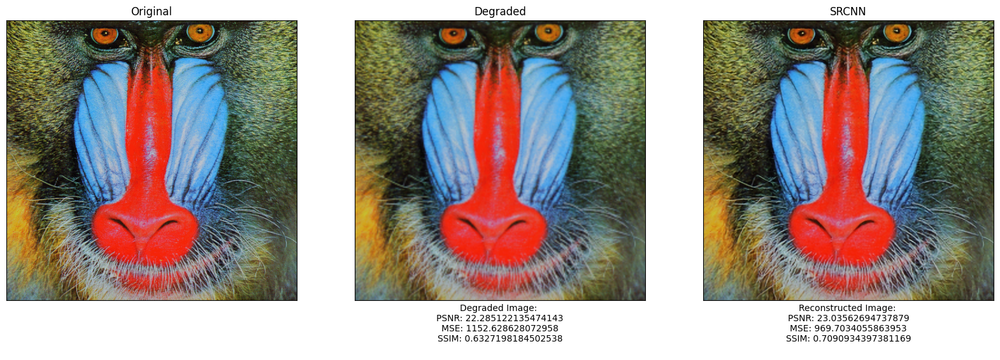

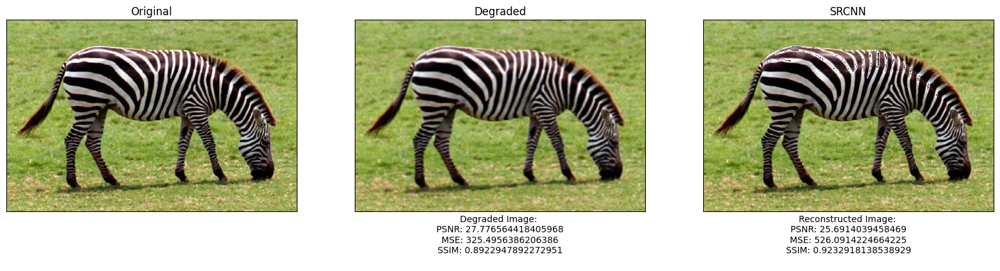

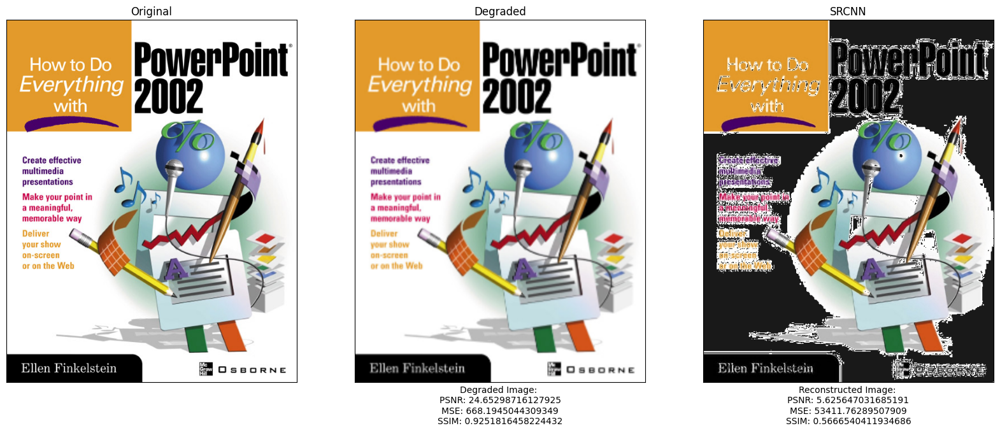

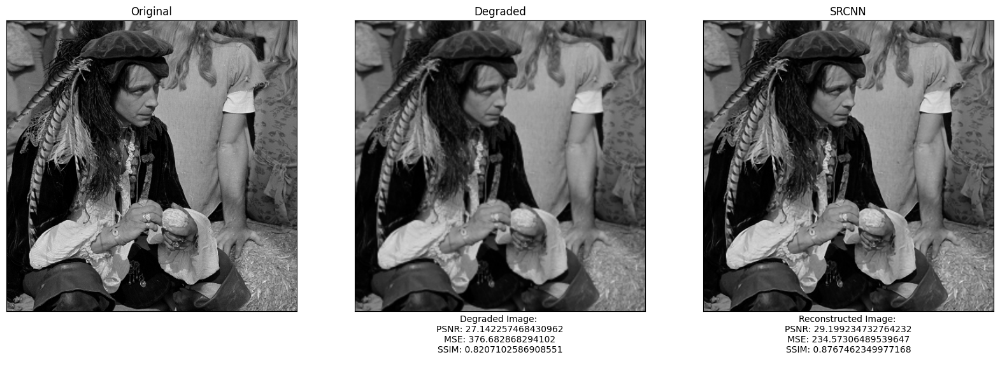

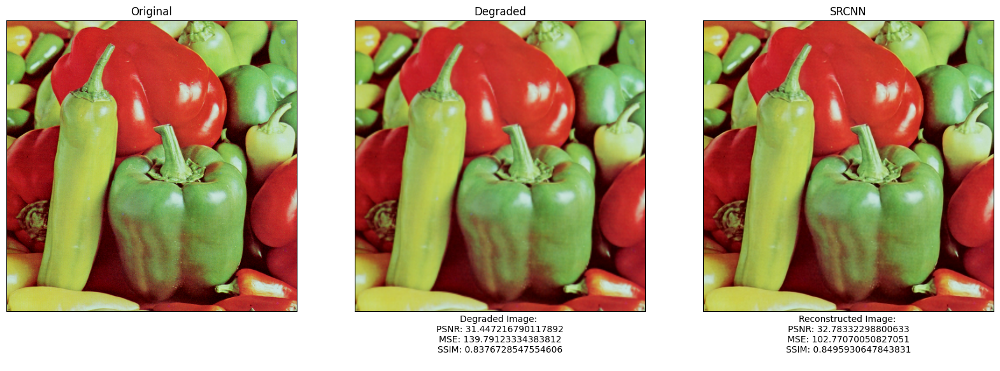

...

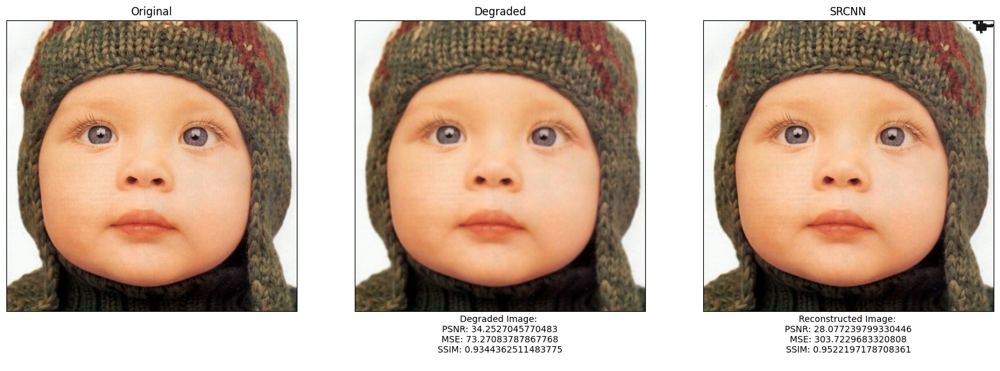

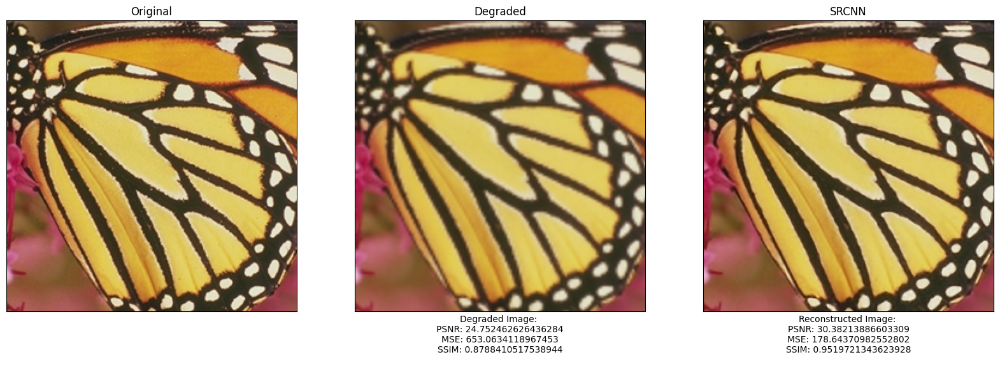

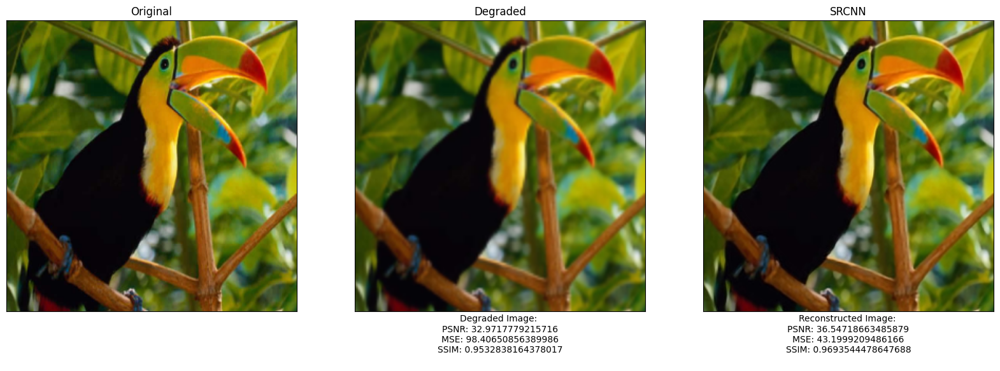

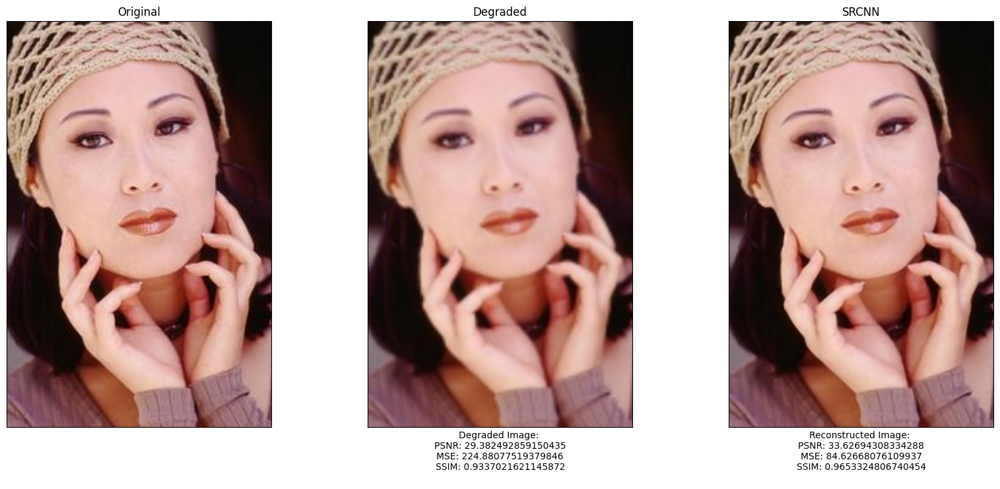

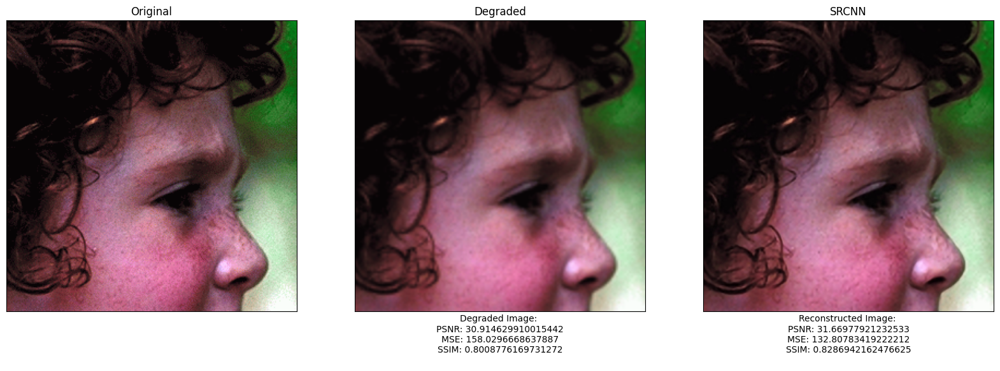

In [ ]:
for file in os.listdir('/content/drive/MyDrive/images'):

    # perform super-resolution

    ref, degraded, output, scores = predict('/content/drive/MyDrive/images/{}'.format(file))


    # display images as subplots
    fig, axs = plt.subplots(1, 3, figsize=(20, 8))
    axs[0].imshow(cv2.cvtColor(ref, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Original')
    axs[1].imshow(cv2.cvtColor(degraded, cv2.COLOR_BGR2RGB))
    axs[1].set_title('Degraded')
    #displaying the scores of degraded images
    axs[1].set(xlabel = 'Degraded Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[0][0], scores[0][1], scores[0][2]))
    axs[2].imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
    axs[2].set_title('SRCNN')
    #displaying the scores of srcnn images
    axs[2].set(xlabel = 'Reconstructed Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[1][0], scores[1][1], scores[1][2]))
    # remove the x and y ticks
    for ax in axs:
      ax.set_xticks([])
      ax.set_yticks([])




In [ ]:
for file in os.listdir('/content/drive/MyDrive/images'):

    ref, degraded, output, scores = predict('/content/drive/MyDrive/images/{}'.format(file))
    # perform super-resolution
    scores = []

    scores.append(compare_images(degraded, ref))#degraded wrt ref
    scores.append(compare_images(output, ref))




    print('Degraded Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[0][0], scores[0][1], scores[0][2]))
    print('Reconstructed Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[1][0], scores[1][1], scores[1][2]))


1/1 [==============================] - 1s 998ms/step


<ipython-input-48-e76d2b18cd91>:22: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  s = structural_similarity(target, ref,multichannel=True)


Degraded Image: 
PSNR: 22.285122135474143
MSE: 1152.628628072958
SSIM: 0.6327198184502538

Reconstructed Image: 
PSNR: 23.03562694737879
MSE: 969.7034055863953
SSIM: 0.7090934397381169

1/1 [==============================] - 1s 1s/step
Degraded Image: 
PSNR: 27.776564418405968
MSE: 325.4956386206386
SSIM: 0.8922947892272951

Reconstructed Image: 
PSNR: 25.6914039458469
MSE: 526.0914224664225
SSIM: 0.9232918138538929

1/1 [==============================] - 2s 2s/step
Degraded Image: 
PSNR: 24.65298716127925
MSE: 668.1945044309349
SSIM: 0.9251816458224432

Reconstructed Image: 
PSNR: 5.625647031685191
MSE: 53411.76289507909
SSIM: 0.5666540411934686

1/1 [==============================] - 2s 2s/step
Degraded Image: 
PSNR: 27.142257468430962
MSE: 376.682868294102
SSIM: 0.8207102586908551

Reconstructed Image: 
PSNR: 29.199234732764232
MSE: 234.57306489539647
SSIM: 0.8767462349977168

1/1 [==============================] - 1s 1s/step
Degraded Image: 
PSNR: 31.447216790117892
MSE: 139.791233

**7.Displaying output for one image**

In [ ]:
def display_srcnn_image(imgpath):

  ref,degraded,output, scores=predict(imgpath)
  # print all scores for all images
  #print('Degraded Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[0][0], scores[0][1], scores[0][2]))
  #print('Reconstructed Image: \nPSNR: {}\nMSE: {}\nSSIM: {}\n'.format(scores[1][0], scores[1][1], scores[1][2]))

  # display images as subplots
  fig, axs = plt.subplots(1, 3, figsize=(20, 8))#1 row,3 columns
  axs[0].imshow(cv2.cvtColor(ref, cv2.COLOR_BGR2RGB))#first subplot
  #imshow assumes RGB images but cv2 loads images as BGR else channel mixing will take place and we will get weird images
  axs[0].set_title('Original')
  axs[1].imshow(cv2.cvtColor(degraded, cv2.COLOR_BGR2RGB))#2nd subplot
  axs[1].set_title('Degraded')
  axs[1].set(xlabel = 'PSNR: {} \nMSE: {} \nSSIM: {}'.format(scores[0][0], scores[0][1], scores[0][2]))
  axs[2].imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))
  axs[2].set_title('SRCNN')
  axs[2].set(xlabel = 'PSNR: {} \nMSE: {} \nSSIM: {}'.format(scores[1][0], scores[1][1], scores[1][2]))


  # remove the x and y ticks
  for ax in axs:
    ax.set_xticks([])#leave them blank to remove ticks
    ax.set_yticks([])

1/1 [==============================] - 1s 807ms/step


<ipython-input-48-e76d2b18cd91>:22: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  s = structural_similarity(target, ref,multichannel=True)


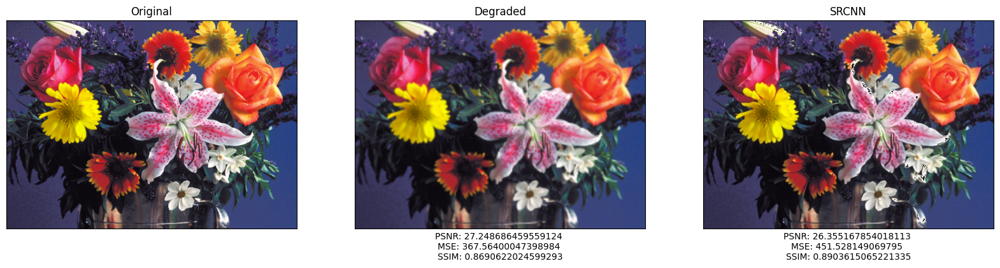

In [ ]:
imgpath = '/content/drive/MyDrive/images/flowers.bmp'
display_srcnn_image(imgpath)

Conclusion: The model is trained to minimize the pixel-wise MSE between the reconstructed and ground truth image. A variety of model architectures and hyperparameter is tested and traded for performance and speed in the paper. Each component of the SRCNN is represented as one convolutional layer from three layers, to improve the image resolution and the mean squared error is minimized for accurate image resolution.

### Image Super-Resolution using EDSR


In [ ]:
pip install super_image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.0/91.0 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 5.5 MB/s eta 0:00:00


In [ ]:
pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.2/486.2 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 6.7 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 8.9 MB/s eta 0:00:00


In [ ]:
from datasets import load_dataset

dataset = load_dataset('eugenesiow/Set5', 'bicubic_x2', split='validation')

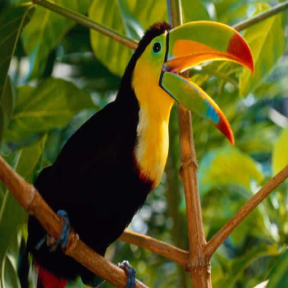

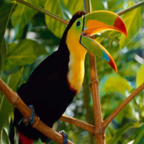

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

cv2_imshow(cv2.imread(dataset[1]["hr"]))
cv2_imshow(cv2.imread(dataset[1]["lr"]))

In [ ]:
from super_image import EdsrModel
from super_image.data import EvalDataset, EvalMetrics

eval_dataset = EvalDataset(dataset)
model = EdsrModel.from_pretrained('eugenesiow/edsr-base', scale=2)
EvalMetrics().evaluate(model, eval_dataset)

https://huggingface.co/eugenesiow/edsr-base/resolve/main/pytorch_model_2x.pt


/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:649: FutureWarning: 'cached_download' is the legacy way to download files from the HF hub, please consider upgrading to 'hf_hub_download'
  warnings.warn(


Evaluating dataset:   0%|          | 0/5 [00:00<?, ?it/s]

scale:2      eval psnr: 38.02     ssim: 0.9607


/usr/local/lib/python3.10/dist-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


1/1 [==============================] - 0s 450ms/step


<ipython-input-48-e76d2b18cd91>:22: FutureWarning: `multichannel` is a deprecated argument name for `structural_similarity`. It will be removed in version 1.0. Please use `channel_axis` instead.
  s = structural_similarity(target, ref,multichannel=True)


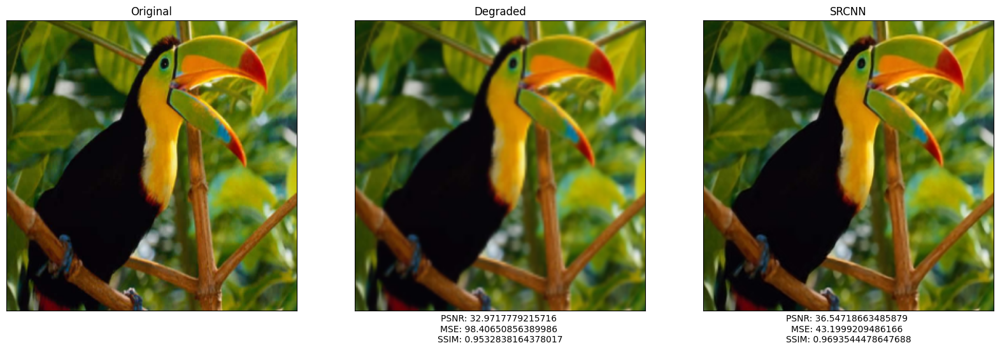

In [ ]:
imgpath = '/content/drive/MyDrive/images/bird_GT.bmp'

display_srcnn_image(imgpath)

EDSR has a higher PSNR score and higher structural similarity compared to the SRCNN model. However, this can be improved by changing the factor of image resolution for both SRCNN and for PSNR.